# Annotations using clustering for cells for lymph_node_s0

In [1]:
slide_id = "lymph_node_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_lymph_node_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 30987, 28915), (3, 15494, 14458)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 13) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (702300, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (702300, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (702300, 4624)
      └── 'table_nuclei': AnnData (702300, 7053)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 702300 × 4624
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,nucleus_count,segmentation_method,region,z_level
0,aaaaaaaa-1,271,0,0,0,0,0,271,87.332191,46.646408,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
1,aaaaaaab-1,315,0,0,0,0,0,315,43.530627,21.900782,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
2,aaaaaaac-1,337,0,0,0,0,0,337,58.206408,27.996876,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
3,aaaaaaad-1,235,0,0,0,0,0,235,34.273595,23.120001,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
5,aaaaaaae-1,216,0,0,0,0,0,216,35.312189,23.842501,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
708978,aaaklhfh-1,92,0,0,0,0,0,92,19.823594,19.823594,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0
708979,aaaklhfi-1,118,0,0,0,0,0,118,13.095313,13.095313,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0
708980,aaaklhfj-1,43,0,0,0,0,0,43,7.676563,7.676563,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,6.0
708981,aaaklhfk-1,20,0,0,0,0,0,20,13.275938,13.275938,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,4.0


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
A2ML1,ENSG00000166535,Gene Expression,Unknown
AAMP,ENSG00000127837,Gene Expression,Unknown
AAR2,ENSG00000131043,Gene Expression,Unknown
AARSD1,ENSG00000266967,Gene Expression,Unknown
ABAT,ENSG00000183044,Gene Expression,Unknown
...,...,...,...
ZSCAN26,ENSG00000197062,Gene Expression,Unknown
ZSWIM6,ENSG00000130449,Gene Expression,Unknown
ZUP1,ENSG00000153975,Gene Expression,Unknown
ZYG11B,ENSG00000162378,Gene Expression,Unknown


In [3]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 692384 × 7053
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'leiden', 'log1p', 'pca', 'pca_n20_pcs16', 'pca_n20_pcs16_leiden_res0.2_colors', 'pca_n20_pcs16_leiden_res0.4_colors', 'pca_n20_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n20_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n20_pcs16_connectivities', 'pca_n20_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n20_pcs16_leiden_res0.2,pca_n20_pcs16_leiden_res0.4,pca_n20_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,44.569126,Intermediate EPCAM+ erythroblast,148,2,8,5,5,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,20.071997,S100A+ preNeutrophil (cycling),189,5,6,12,12,T,Treg,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,26.416594,Gamma-delta T cell,208,5,6,12,12,T,Treg,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,21.200974,pre-pDC (lymphoid origin),200,5,3,2,2,pDC,pDC,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,22.329712,preB cell (cycling),223,3,10,11,11,B,B,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaaklhfh-1,nucleus_boundaries,morpho,aaaklhfh-1,18.333292,Tissue-resident NK cell,80,8,11,15,15,Endothelial,Endothelial,normal_cell
aaaklhfi-1,nucleus_boundaries,morpho,aaaklhfi-1,11.695614,MAIT,116,4,1,8,8,Fibroblast,Fibroblast,normal_cell
aaaklhfj-1,nucleus_boundaries,morpho,aaaklhfj-1,6.322290,Intermediate EPCAM+ erythroblast,36,6,8,14,14,T,T,normal_cell
aaaklhfk-1,nucleus_boundaries,morpho,aaaklhfk-1,11.764376,Fibroblast,20,4,0,1,1,Unknown,Unknown,normal_cell


In [9]:
adata_nuclei.var

,mean,std
A2ML1,0.003378,0.116929
AAMP,0.186632,0.859907
AAR2,0.050775,0.453682
AARSD1,0.086071,0.584174
ABAT,0.033823,0.368731
...,...,...
ZSCAN26,0.100363,0.632614
ZSWIM6,0.040793,0.401486
ZUP1,0.074976,0.545812
ZYG11B,0.085408,0.583948


## 2. Preprocessing

<Axes: >

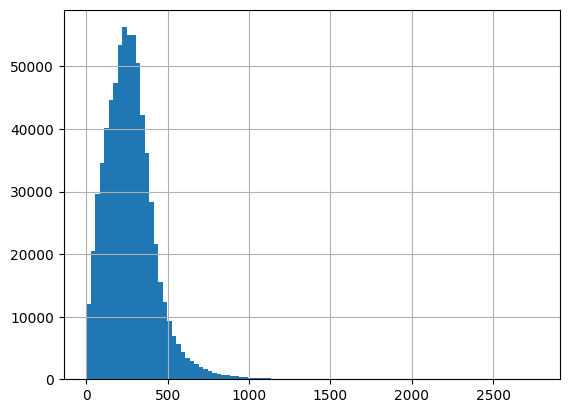

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

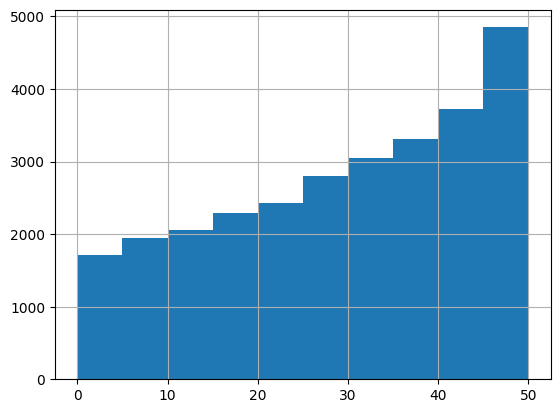

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 8006
Percentage of cells with less than 20 transcripts: 1.14%
-----
Number of cells with less than 15 transcripts: 5709
Percentage of cells with less than 15 transcripts: 0.81%
-----
Number of cells with less than 10 transcripts: 3658
Percentage of cells with less than 10 transcripts: 0.52%
-----
Number total of cells: 702300


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

698216


In [15]:
# Save and do clustering on ruche using gpu
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_att/adata_cells_for_gpu_clustering_{slide_id}.h5ad")

In [14]:
# # Save the raw data
# adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# # Normalize
# sc.pp.normalize_total(adata_cells, target_sum=1e4)
# sc.pp.log1p(adata_cells)
# adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# # Scale each gene to unit variance. Clip values exceeding standard deviation 10.
# sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [ ]:
# # Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
# sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

In [ ]:
# # Contribution of single PCs to the total variance in the data
# # This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
# sc.pl.pca_variance_ratio(adata_cells, log=True)

In [ ]:
# adata_cells

In [20]:
# # Restore X to be log norm counts
# # /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
# dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [ ]:
# # Neighborhood graph of cells using the PCA representation of the data matrix
# sc.pp.neighbors(adata_cells, n_neighbors=20, n_pcs=16, use_rep="X_pca", key_added='pca_n20_pcs16')
# # Embedding the neighborhood graph using UMAP
# sc.tl.umap(adata_cells, neighbors_key='pca_n20_pcs16')
# # Leiden clustering directly clusters the neighborhood graph of cells
# sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n20_pcs16_leiden_res0.2', neighbors_key='pca_n20_pcs16')
# sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n20_pcs16_leiden_res0.4', neighbors_key='pca_n20_pcs16')
# sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n20_pcs16_leiden_res0.6', neighbors_key='pca_n20_pcs16')

In [6]:
# reload adata after clustring on ruche
adata_cells = sc.read_h5ad(f"/Users/felicie-giraud-sauveur/Documents/HE2CellType/code/CT_DS/data/adata_att_clustering/adata_cells_after_gpu_clustering_{slide_id}.h5ad")

In [7]:
adata_cells

AnnData object with n_obs × n_vars = 698216 × 4624
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'leiden', 'log1p', 'pca', 'pca_n20_pcs16', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n20_pcs16_connectivities', 'pca_n20_pcs16_distances'

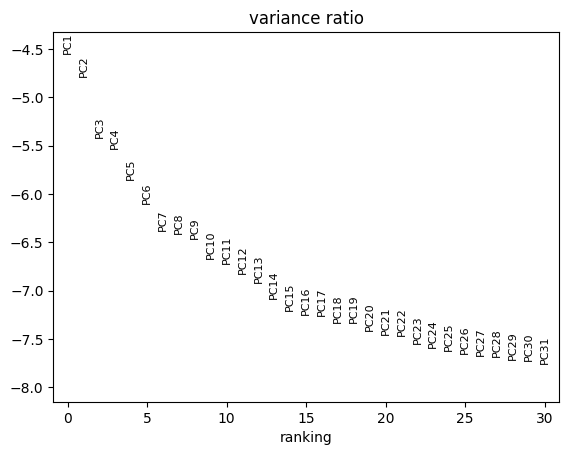

In [8]:
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [9]:
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
print(f"Sum count: {adata_cells.layers['count'].sum()}")
print(f"Sum log_norm: {adata_cells.layers['log_norm'].sum()}")
print(f"Sum X: {adata_cells.X.sum()}")

Sum count: 189482960.0
Sum log_norm: 566456384.0
Sum X: 566456384.0


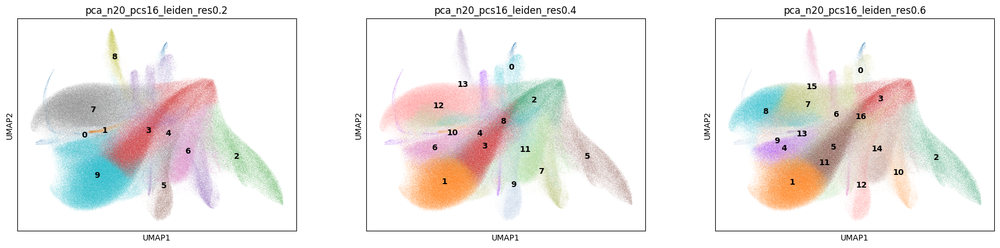

In [10]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n20_pcs16',
           color=['pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [12]:
# Number of clusters
adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].unique()

['8', '1', '7', '12', '3', ..., '2', '4', '9', '10', '0']
Length: 14
Categories (14, object): ['0', '1', '2', '3', ..., '10', '11', '12', '13']

In [13]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['11']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['12']), 'refine_res'] = '12'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.4'].isin(['13']), 'refine_res'] = '13'

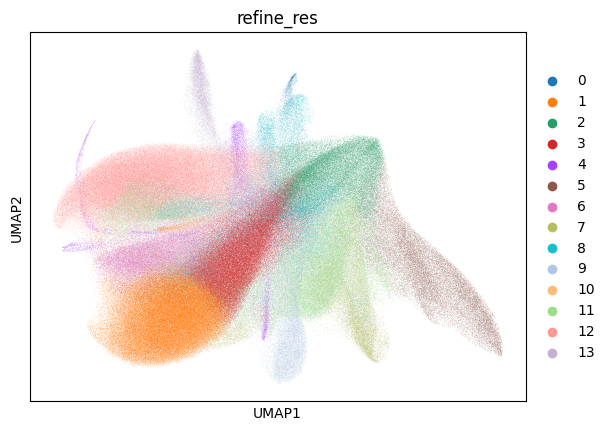

In [14]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n20_pcs16', color=['refine_res'])

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [15]:
clustering_label = 'refine_res'

In [16]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

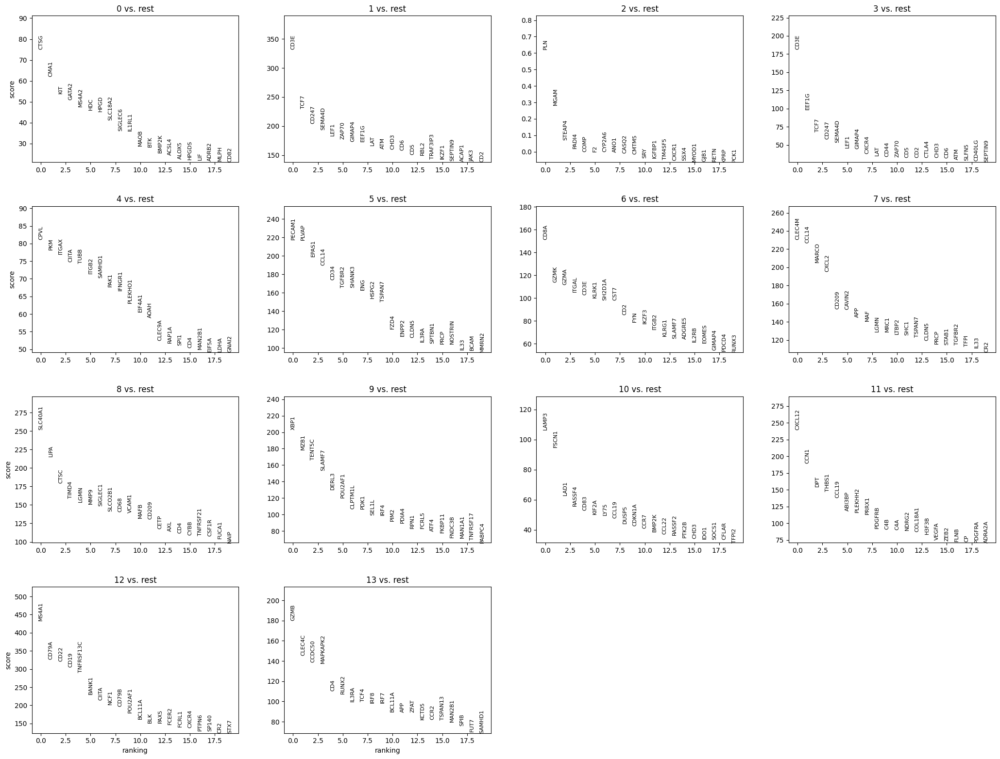

In [17]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [18]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [19]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [20]:
cluster_id = '0'

In [21]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Macrophage/DC,Macrophage/DC,normal_cell,39.2
1,B,B,normal_cell,16.9
2,T,T,normal_cell,14.7
3,T,Treg,normal_cell,8.8
4,Unknown,Unknown,normal_cell,8.7


In [22]:
top_ranked_genes[cluster_id]

0     CTSG
1     CMA1
2      KIT
3    GATA2
4    MS4A2
5      HDC
6     HPGD
Name: 0, dtype: object

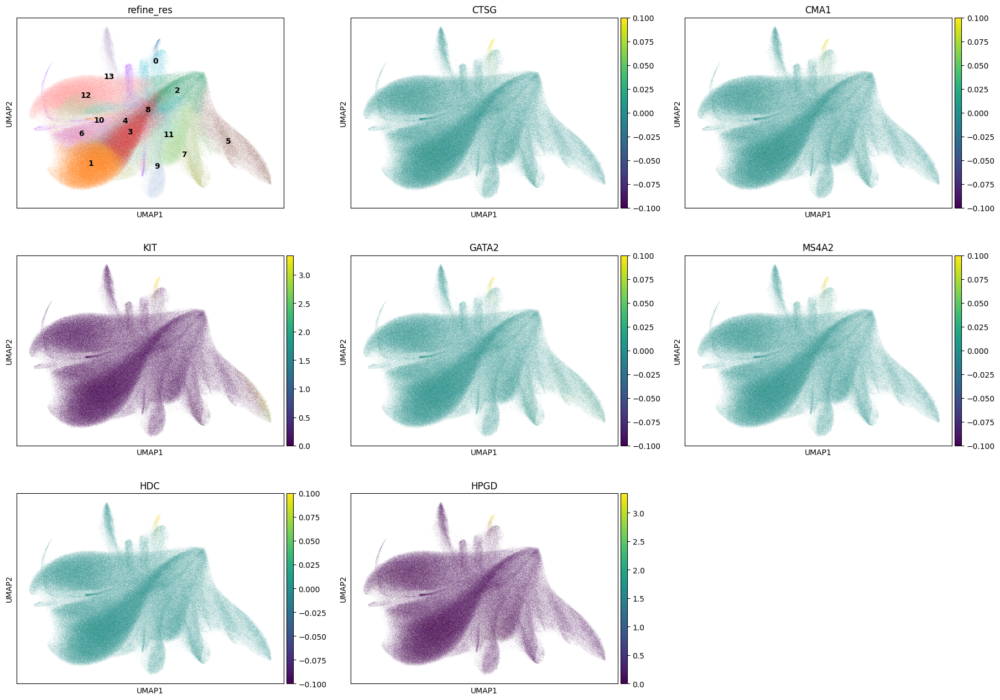

In [23]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [24]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 2668
Percentage of cells in cluster 0: 0.4


In [25]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.2. Cluster 1

In [26]:
cluster_id = '1'

In [27]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,51.4
1,T,Treg,normal_cell,41.4
2,Fibroblast,Fibroblast,normal_cell,2.6
3,B,B,normal_cell,1.9
4,T/NK,T/NK,normal_cell,1.4


In [28]:
top_ranked_genes[cluster_id]

0      CD3E
1      TCF7
2     CD247
3    SEMA4D
4      LEF1
5     ZAP70
6    GIMAP4
Name: 1, dtype: object

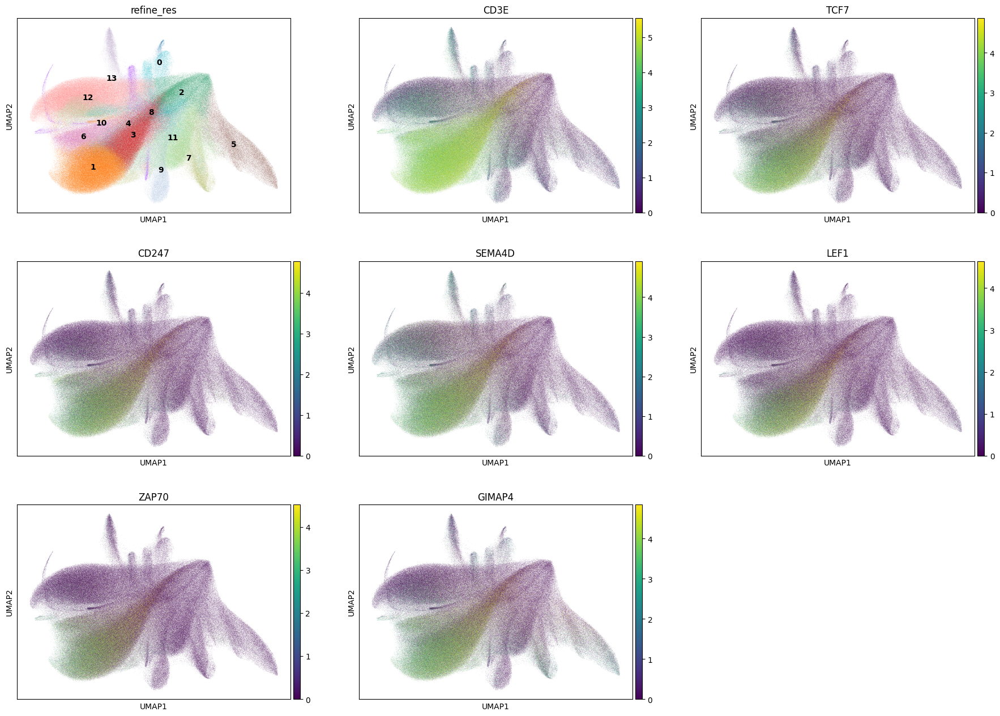

In [29]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [30]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 138555
Percentage of cells in cluster 1: 19.8


In [31]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.3. Cluster 2

In [32]:
cluster_id = '2'

In [33]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Unknown,Unknown,normal_cell,49.7
1,T,T,normal_cell,20.0
2,B,B,normal_cell,12.2
3,NA,NA,NA,9.3
4,Fibroblast,Fibroblast,normal_cell,5.2


In [34]:
top_ranked_genes[cluster_id]

0       PLN
1      MGAM
2    STEAP4
3     PADI4
4      COMP
5        F2
6    CYP2A6
Name: 2, dtype: object

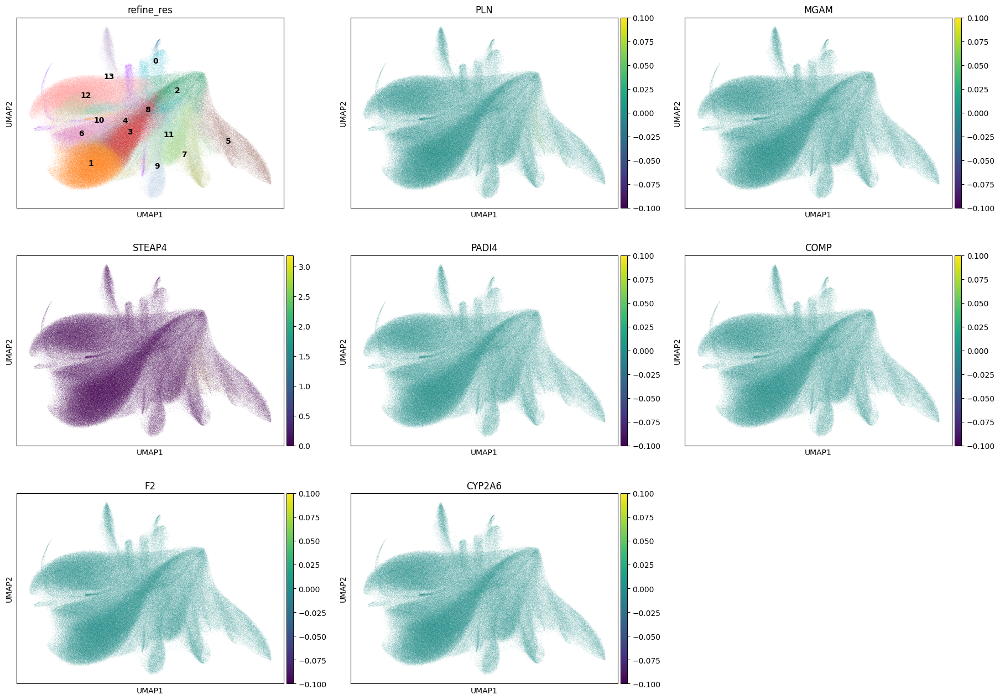

In [35]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [36]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 49630
Percentage of cells in cluster 2: 7.1


In [37]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.4. Cluster 3

In [38]:
cluster_id = '3'

In [39]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,67.6
1,T,Treg,normal_cell,16.7
2,Fibroblast,Fibroblast,normal_cell,4.9
3,B,B,normal_cell,3.0
4,Unknown,Unknown,normal_cell,2.4


In [40]:
top_ranked_genes[cluster_id]

0      CD3E
1     EEF1G
2      TCF7
3     CD247
4    SEMA4D
5      LEF1
6    GIMAP4
Name: 3, dtype: object

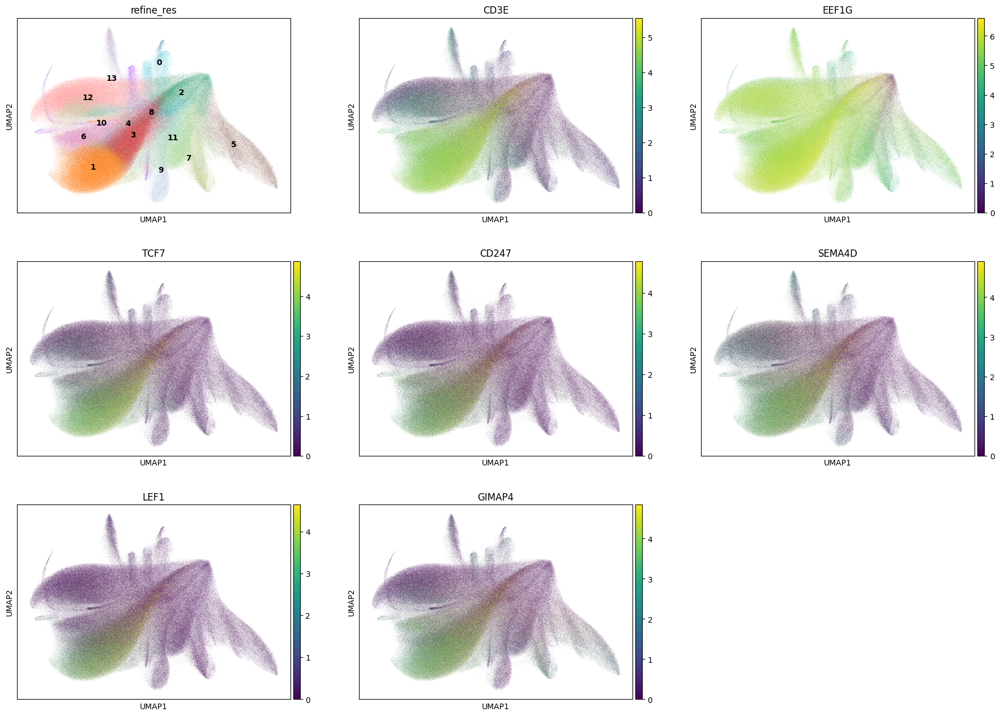

In [41]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [42]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 94077
Percentage of cells in cluster 3: 13.5


In [43]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.5. Cluster 4

In [44]:
cluster_id = '4'

In [45]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Macrophage/DC,Macrophage/DC,normal_cell,46.8
1,Proliferating_B_T,Proliferating_B_T,normal_cell,11.8
2,T,T,normal_cell,10.1
3,Fibroblast,Fibroblast,normal_cell,9.2
4,T,Treg,normal_cell,7.3


In [46]:
top_ranked_genes[cluster_id]

0      CPVL
1       PKM
2     ITGAX
3     CIITA
4      TUBB
5     ITGB2
6    SAMHD1
Name: 4, dtype: object

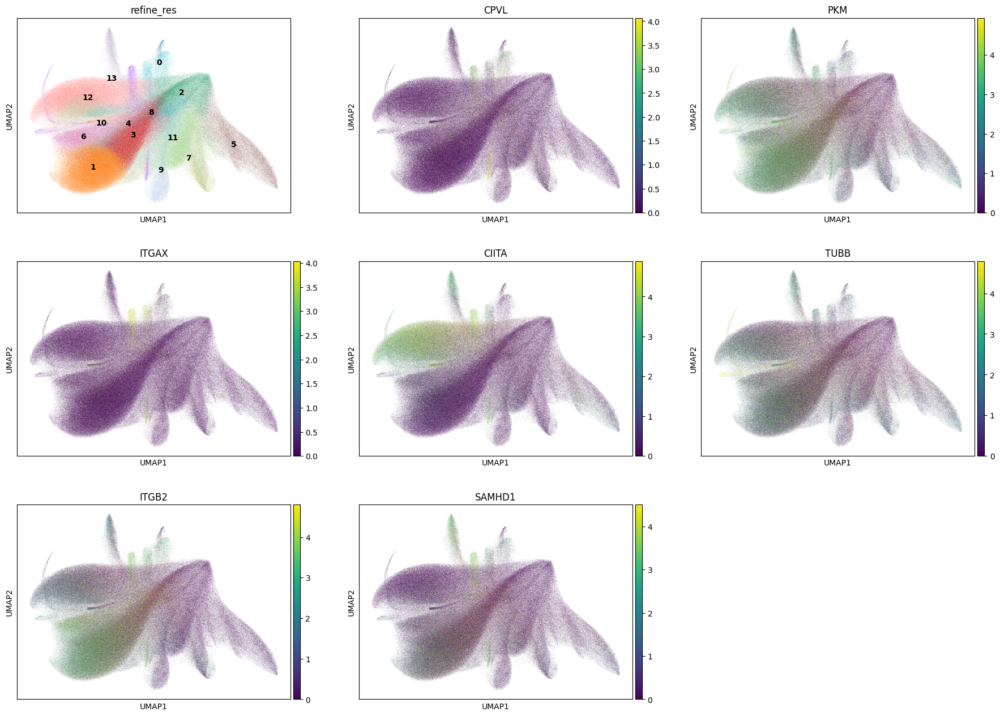

In [47]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [48]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 20925
Percentage of cells in cluster 4: 3.0


In [49]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage/DC'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage/DC'

### 5.6. Cluster 5

In [50]:
cluster_id = '5'

In [51]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,78.7
1,Unknown,Unknown,normal_cell,7.8
2,Fibroblast,Fibroblast,normal_cell,5.1
3,T,T,normal_cell,2.2
4,NA,NA,NA,1.6


In [52]:
top_ranked_genes[cluster_id]

0    PECAM1
1     PLVAP
2     EPAS1
3     CCL14
4      CD34
5    TGFBR2
6    SHANK3
Name: 5, dtype: object

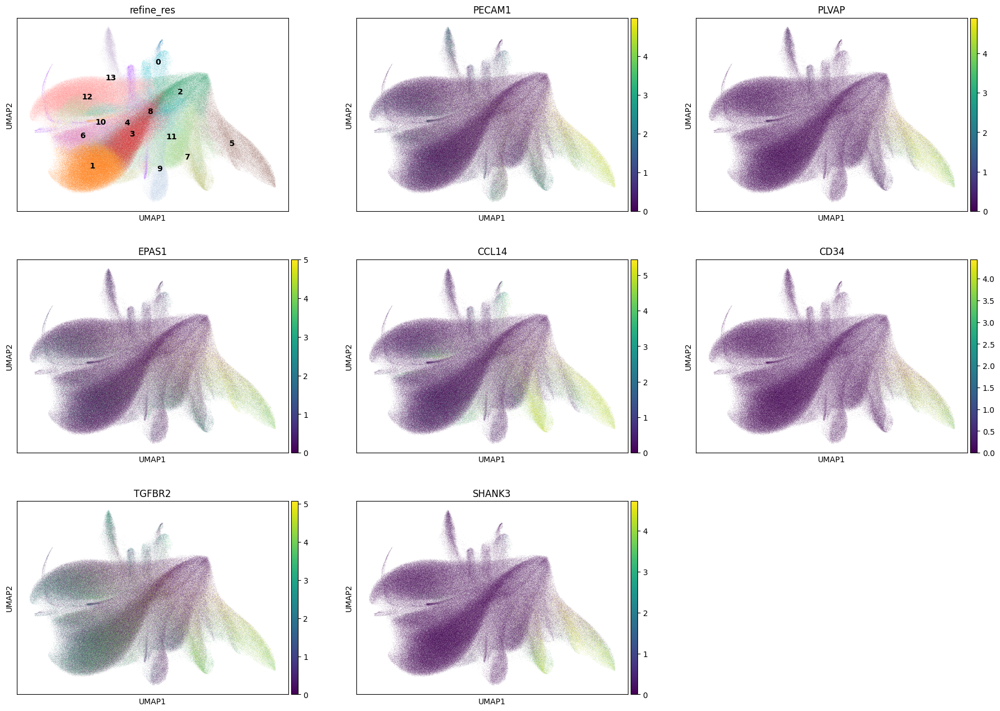

In [53]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [54]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 39823
Percentage of cells in cluster 5: 5.7


In [55]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.7. Cluster 6

In [56]:
cluster_id = '6'

In [57]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T/NK,T/NK,normal_cell,71.1
1,T,Treg,normal_cell,12.4
2,T,T,normal_cell,9.8
3,B,B,normal_cell,2.9
4,Fibroblast,Fibroblast,normal_cell,1.7


In [58]:
top_ranked_genes[cluster_id]

0      CD8A
1      GZMK
2      GZMA
3     ITGAL
4      CD3E
5     KLRK1
6    SH2D1A
Name: 6, dtype: object

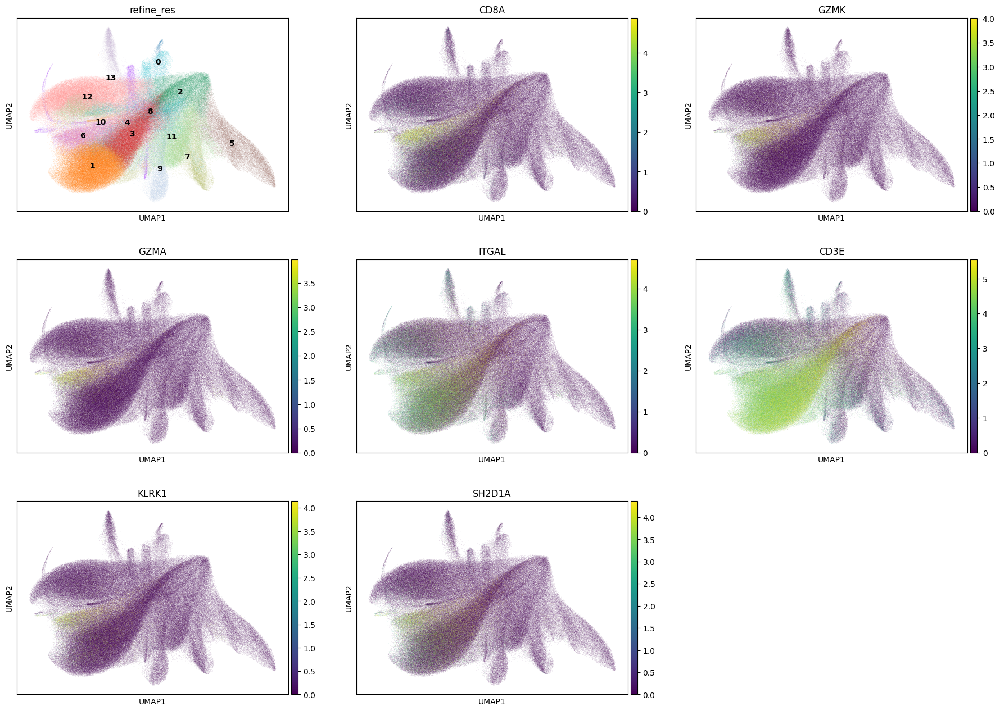

In [59]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [60]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 26878
Percentage of cells in cluster 6: 3.8


In [61]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T/NK'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T/NK'

### 5.8. Cluster 7

In [62]:
cluster_id = '7'

In [63]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,54.5
1,T,T,normal_cell,14.0
2,B,B,normal_cell,12.3
3,Unknown,Unknown,normal_cell,7.6
4,Fibroblast,Fibroblast,normal_cell,5.4


In [64]:
top_ranked_genes[cluster_id]

0    CLEC4M
1     CCL14
2     MARCO
3     CXCL2
4     CD209
5    CAVIN2
6       APP
Name: 7, dtype: object

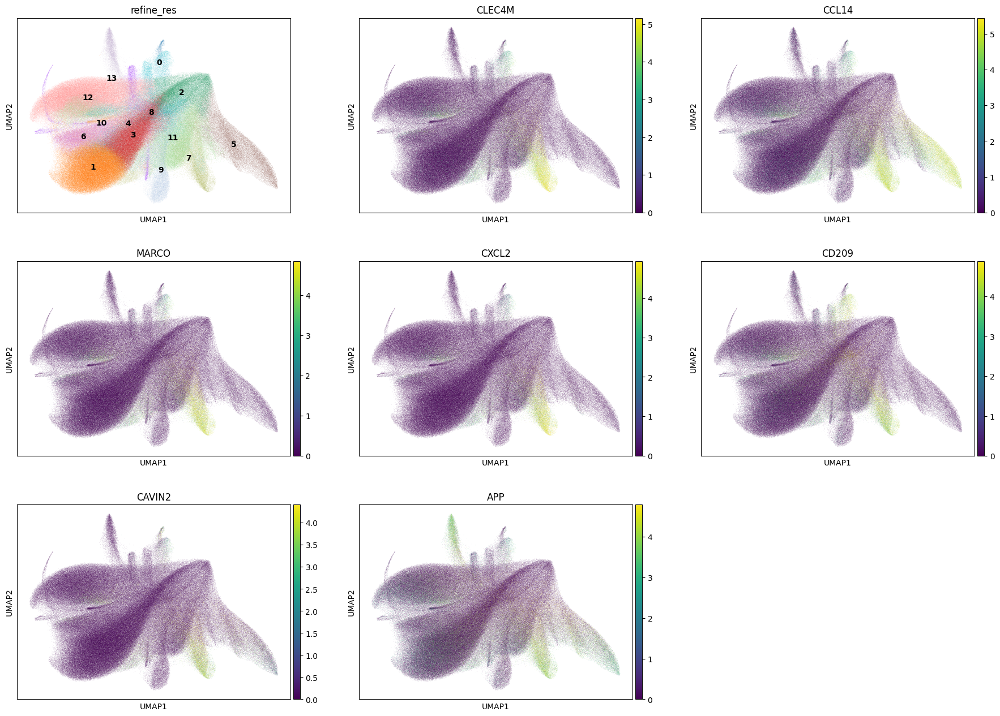

In [65]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [66]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 38115
Percentage of cells in cluster 7: 5.5


In [67]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage/DC'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage/DC'

### 5.9. Cluster 8

In [68]:
cluster_id = '8'

In [69]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,54.0
1,Unknown,Unknown,normal_cell,13.7
2,B,B,normal_cell,12.3
3,T,T,normal_cell,7.6
4,Fibroblast,Fibroblast,normal_cell,5.0


In [70]:
top_ranked_genes[cluster_id]

0    SLC40A1
1       LIPA
2       CTSC
3      TIMD4
4       LGMN
5       MMP9
6    SIGLEC1
Name: 8, dtype: object

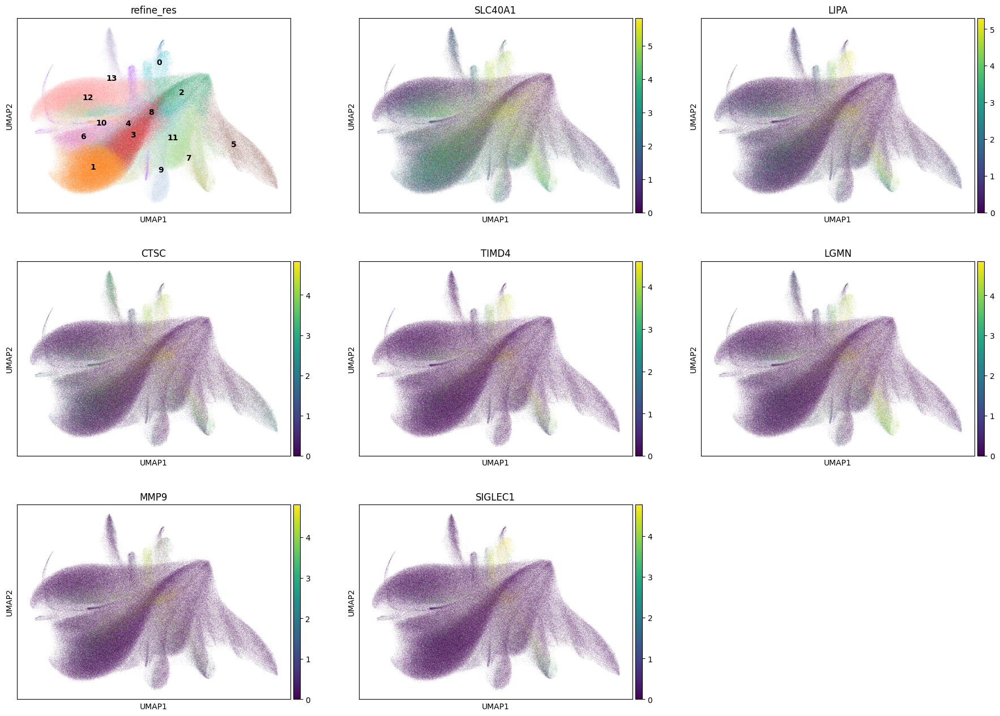

In [71]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [72]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 42616
Percentage of cells in cluster 8: 6.1


In [73]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.10. Cluster 9

In [74]:
cluster_id = '9'

In [75]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,79.5
1,Fibroblast,Fibroblast,normal_cell,5.7
2,B,B,normal_cell,5.6
3,Unknown,Unknown,normal_cell,3.7
4,T,T,normal_cell,2.8


In [76]:
top_ranked_genes[cluster_id]

0       XBP1
1       MZB1
2     TENT5C
3     SLAMF7
4      DERL3
5    POU2AF1
6    CLPTM1L
Name: 9, dtype: object

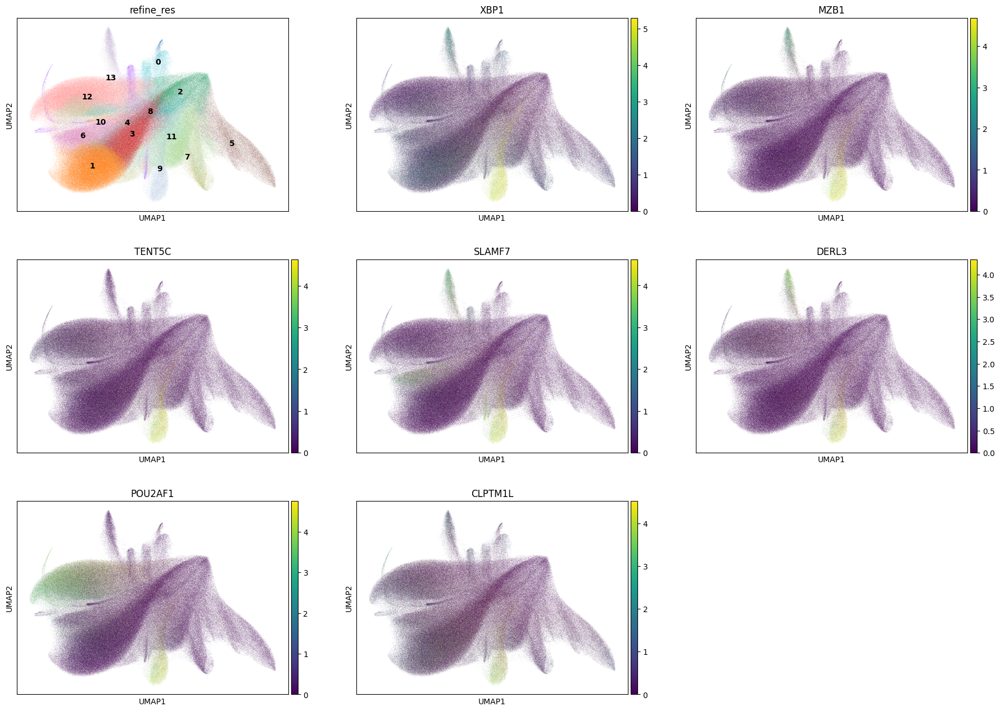

In [77]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [78]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 21783
Percentage of cells in cluster 9: 3.1


In [79]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.11. Cluster 10

In [80]:
cluster_id = '10'

In [81]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,DC,DC,normal_cell,46.0
1,T,T,normal_cell,27.1
2,T,Treg,normal_cell,16.4
3,Fibroblast,Fibroblast,normal_cell,2.8
4,B,B,normal_cell,2.5


In [82]:
top_ranked_genes[cluster_id]

0     LAMP3
1     FSCN1
2      LAD1
3    RASSF4
4      CD83
5     KIF2A
6      LY75
Name: 10, dtype: object

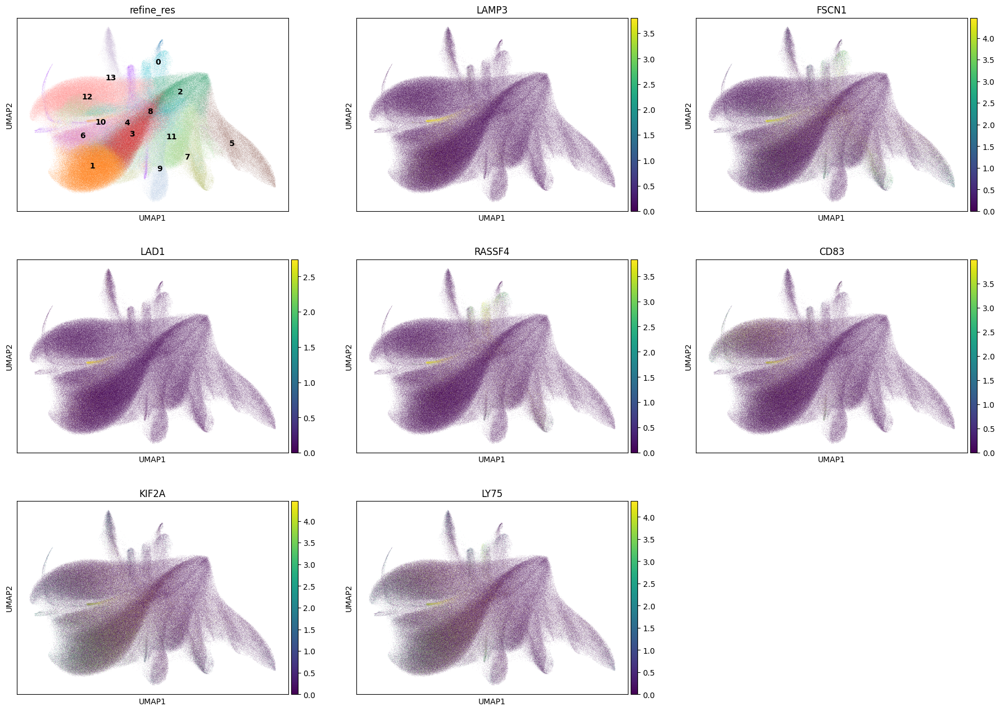

In [83]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [84]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 7542
Percentage of cells in cluster 10: 1.1


In [85]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'DC'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'DC'

### 5.12. Cluster 11

In [86]:
cluster_id = '11'

In [87]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,Fibroblast,normal_cell,71.3
1,B,B,normal_cell,20.2
2,Unknown,Unknown,normal_cell,3.8
3,T,T,normal_cell,1.5
4,T,Treg,normal_cell,1.3


In [88]:
top_ranked_genes[cluster_id]

0     CXCL12
1       CCN1
2        DPT
3      THBS1
4      CCL19
5     ABI3BP
6    PLEKHH2
Name: 11, dtype: object

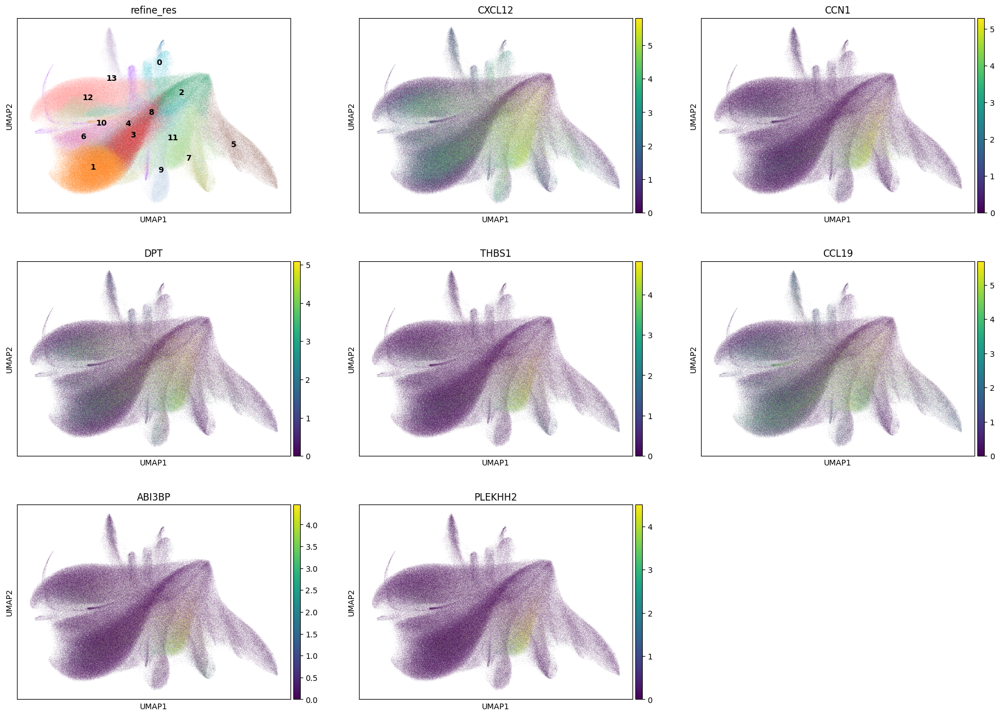

In [89]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [90]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 71135
Percentage of cells in cluster 11: 10.2


In [91]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.13. Cluster 12

In [92]:
cluster_id = '12'

In [93]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,B,normal_cell,92.9
1,T,T,normal_cell,3.3
2,T,Treg,normal_cell,1.8
3,Unknown,Unknown,normal_cell,0.8
4,Fibroblast,Fibroblast,normal_cell,0.4


In [94]:
top_ranked_genes[cluster_id]

0        MS4A1
1        CD79A
2         CD22
3         CD19
4    TNFRSF13C
5        BANK1
6        CIITA
Name: 12, dtype: object

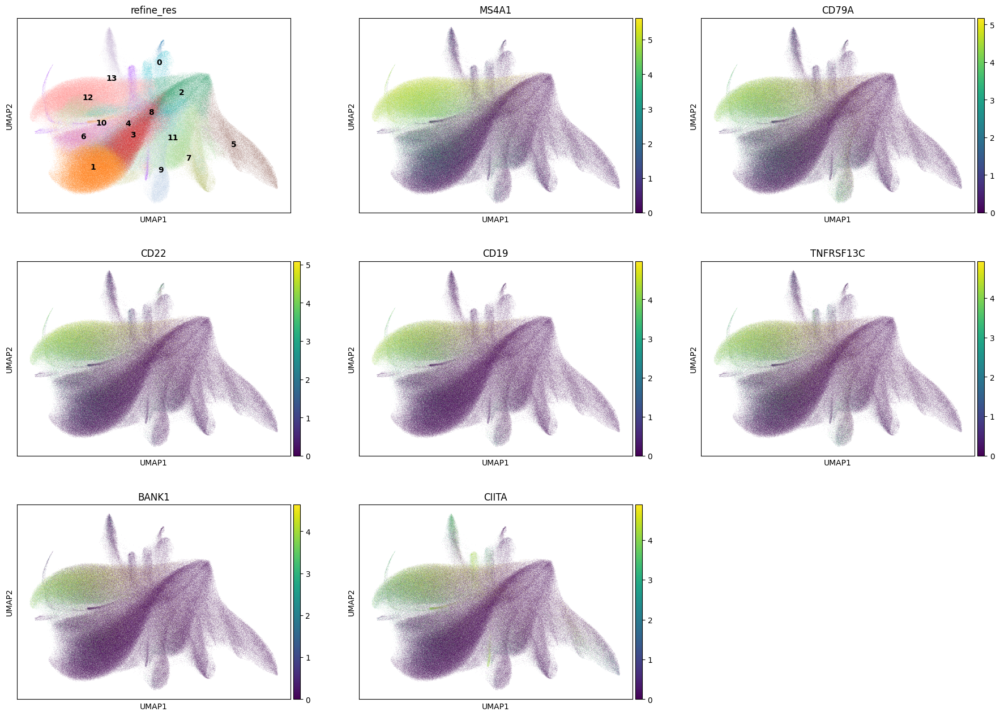

In [95]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [96]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 125048
Percentage of cells in cluster 12: 17.9


In [97]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.14. Cluster 13

In [98]:
cluster_id = '13'

In [99]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,pDC,pDC,normal_cell,70.8
1,T,T,normal_cell,11.7
2,T,Treg,normal_cell,8.0
3,Fibroblast,Fibroblast,normal_cell,2.8
4,B,B,normal_cell,2.8


In [100]:
top_ranked_genes[cluster_id]

0        GZMB
1      CLEC4C
2      CCDC50
3    MAPKAPK2
4         CD4
5       RUNX2
6       IL3RA
Name: 13, dtype: object

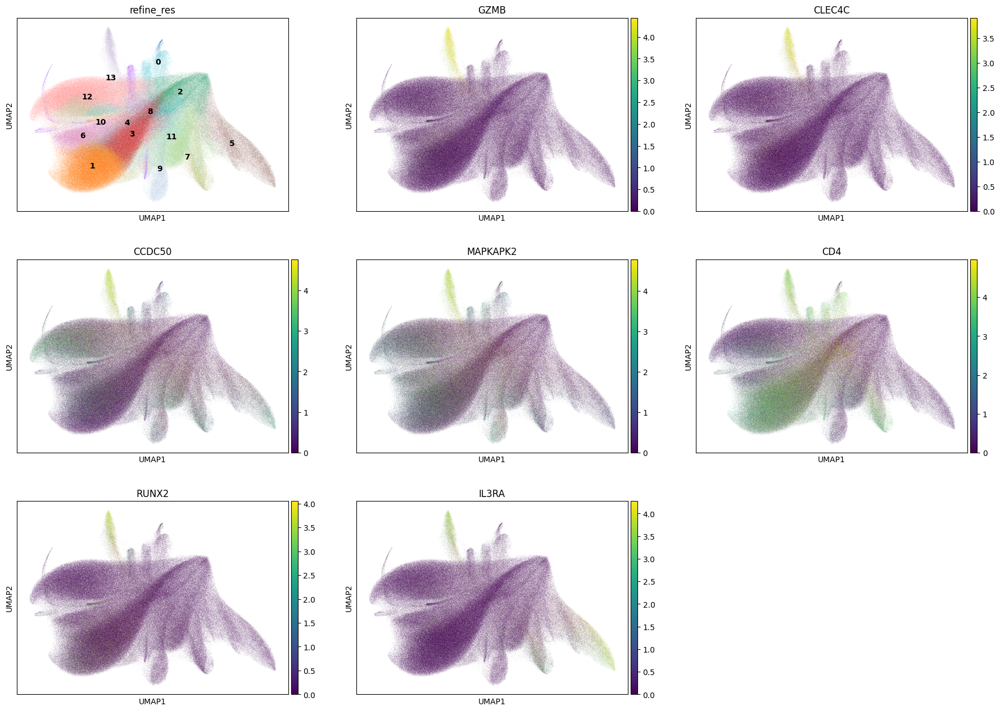

In [101]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [102]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 13: 19421
Percentage of cells in cluster 13: 2.8


In [103]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'pDC'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'pDC'

## 6. Cancer cells

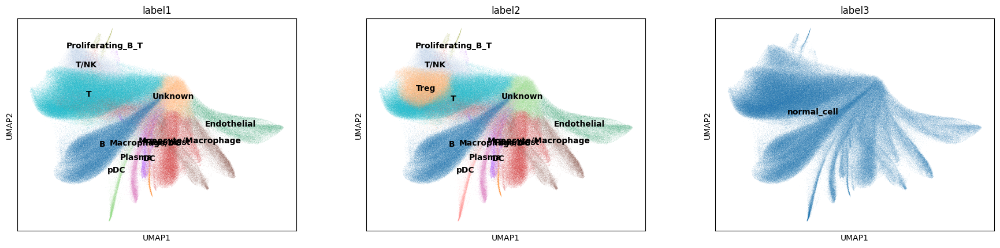

In [104]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

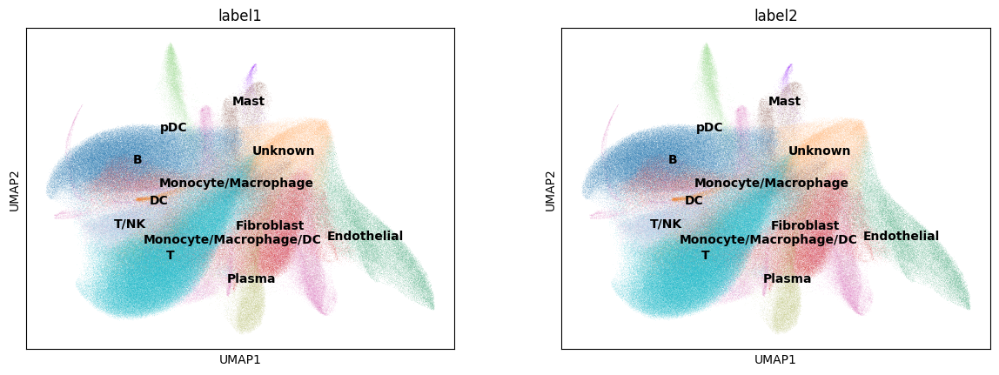

In [105]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [106]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'

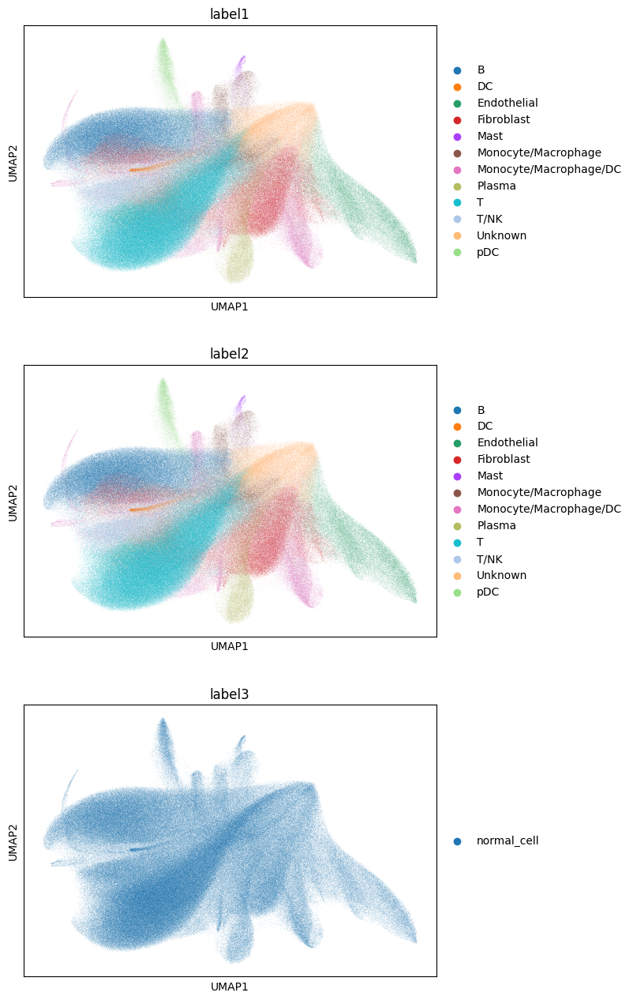

In [107]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [108]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,...,segmentation_method,region,z_level,pca_n20_pcs16_leiden_res0.2,pca_n20_pcs16_leiden_res0.4,pca_n20_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,271,0,0,0,0,0,271,87.332191,46.646408,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,9,8,11,8,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
1,aaaaaaab-1,315,0,0,0,0,0,315,43.530627,21.900782,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,9,1,1,1,T,T,normal_cell
2,aaaaaaac-1,337,0,0,0,0,0,337,58.206408,27.996876,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,9,1,1,1,T,T,normal_cell
3,aaaaaaad-1,235,0,0,0,0,0,235,34.273595,23.120001,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,9,7,11,7,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
5,aaaaaaae-1,216,0,0,0,0,0,216,35.312189,23.842501,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,7,12,8,12,B,B,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
708978,aaaklhfh-1,92,0,0,0,0,0,92,19.823594,19.823594,...,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0,2,5,2,5,Endothelial,Endothelial,normal_cell
708979,aaaklhfi-1,118,0,0,0,0,0,118,13.095313,13.095313,...,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0,6,11,14,11,Fibroblast,Fibroblast,normal_cell
708980,aaaklhfj-1,43,0,0,0,0,0,43,7.676563,7.676563,...,Segmented by nucleus expansion of 5.0µm,cell_labels,6.0,3,2,3,2,Unknown,Unknown,normal_cell
708981,aaaklhfk-1,20,0,0,0,0,0,20,13.275938,13.275938,...,Segmented by nucleus expansion of 5.0µm,cell_labels,4.0,3,2,3,2,Unknown,Unknown,normal_cell


In [109]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")